In [1]:
import geopandas

In [2]:
precincts_2016 = geopandas.read_file('./fl_2016/fl_2016.shp', index_col="countypct")
precincts_2016 = precincts_2016.query('county == "ORA"')
precincts_2016 = precincts_2016.set_index("countypct")

pres_columns = [col for col in precincts_2016.columns if 'G16PRE' in col]
cols_to_keep = pres_columns + ["geometry"]
precincts_2016 = precincts_2016[cols_to_keep]

precincts_2016.loc[:, "votes_all"] = precincts_2016[pres_columns].sum(axis=1)
precincts_2016.rename(columns={"G16PRERTru": "votes_rep", "G16PREDCli": "votes_dem"}, inplace=True)
precincts_2016.loc[:, "votes_oth"] = precincts_2016["votes_all"] - precincts_2016["votes_dem"] - precincts_2016["votes_rep"]

cols_to_keep = ["votes_dem", "votes_rep", "votes_oth", "votes_all", "geometry"]
precincts_2016 = precincts_2016[cols_to_keep]

precincts_2016 = precincts_2016.drop("ORA631")
precincts_2016 = precincts_2016[precincts_2016["votes_all"] > 0]

precincts_2016.loc[:, "frac_dem"] = precincts_2016["votes_dem"] / precincts_2016["votes_all"]
precincts_2016.loc[:, "frac_rep"] = precincts_2016["votes_rep"] / precincts_2016["votes_all"]
precincts_2016.loc[:, "frac_oth"] = precincts_2016["votes_oth"] / precincts_2016["votes_all"]
precincts_2016.loc[:, "frac_twoway_dem"] = precincts_2016["votes_dem"] / precincts_2016[["votes_dem", "votes_rep"]].sum(axis=1)
precincts_2016.loc[:, "frac_twoway_rep"] = precincts_2016["votes_rep"] / precincts_2016[["votes_dem", "votes_rep"]].sum(axis=1)
precincts_2016.loc[:, "margin_votes_dem"] = precincts_2016["votes_dem"] - precincts_2016["votes_rep"]
precincts_2016.loc[:, "margin_frac_dem"] = precincts_2016["frac_dem"] - precincts_2016["frac_rep"]
precincts_2016.loc[:, "margin_frac_twoway_dem"] = precincts_2016["frac_twoway_dem"] - precincts_2016["frac_twoway_rep"]

precincts_2016.loc[:, "centroid"] = precincts_2016["geometry"].centroid.to_crs(epsg=4326)

print("n rows:", len(precincts_2016))
precincts_2016.head()

n rows: 246


,votes_dem,votes_rep,votes_oth,votes_all,geometry,frac_dem,frac_rep,frac_oth,frac_twoway_dem,frac_twoway_rep,margin_votes_dem,margin_frac_dem,margin_frac_twoway_dem,centroid
countypct,,,,,,,,,,,,,,
ORA101,1995,1054,118,3167,"POLYGON Z ((504909.204 1523375.895 0.000, 5049...",0.629934,0.332807,0.037259,0.654313,0.345687,941,0.297127,0.308626,POINT (-81.48674 28.52315)
ORA102,1174,794,97,2065,"POLYGON Z ((499427.900 1523225.458 0.000, 4994...",0.568523,0.384504,0.046973,0.596545,0.403455,380,0.184019,0.193089,POINT (-81.49669 28.53018)
ORA103,978,850,89,1917,"POLYGON Z ((485063.981 1522998.231 0.000, 4849...",0.510172,0.443401,0.046427,0.535011,0.464989,128,0.066771,0.070022,POINT (-81.53799 28.53163)
ORA104,1651,1234,126,3011,"POLYGON Z ((497127.251 1529739.702 0.000, 4971...",0.548323,0.409831,0.041847,0.572270,0.427730,417,0.138492,0.144541,POINT (-81.52151 28.54159)
ORA105,1287,405,60,1752,"POLYGON Z ((477486.115 1540281.324 0.000, 4774...",0.734589,0.231164,0.034247,0.760638,0.239362,882,0.503425,0.521277,POINT (-81.57041 28.55752)


<AxesSubplot:>

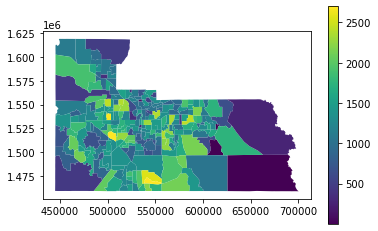

In [3]:
precincts_2016.plot(column='votes_dem', legend=True)

<AxesSubplot:>

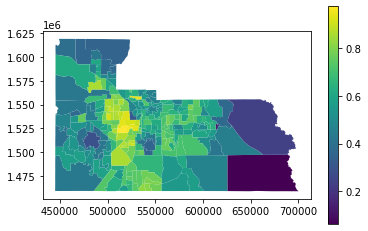

In [4]:
precincts_2016.plot(column='frac_twoway_dem', legend=True)

In [5]:
import plotly.graph_objects as go

In [6]:
precincts_2016[["centroid", "margin_frac_twoway_dem"]]

,centroid,margin_frac_twoway_dem
countypct,,
ORA101,POINT (-81.48674 28.52315),0.308626
ORA102,POINT (-81.49669 28.53018),0.193089
ORA103,POINT (-81.53799 28.53163),0.070022
ORA104,POINT (-81.52151 28.54159),0.144541
ORA105,POINT (-81.57041 28.55752),0.521277
...,...,...
ORA629,POINT (-81.39859 28.53067),0.869854
ORA630,POINT (-81.38945 28.51817),0.528736
ORA632,POINT (-81.41386 28.49938),0.626320


In [7]:
MAPBOX_ACCESSTOKEN = 'pk.eyJ1IjoiZ3Jpc2FpdGlzIiwiYSI6ImNraDhnN3g2bzAyMWkycXIxamR0NXJscmgifQ.vyRCvByr3xNwonFcVco-HA'

In [8]:
data = go.Choroplethmapbox(
    geojson=precincts_2016["geometry"].to_crs(epsg=4326).__geo_interface__,
    locations=precincts_2016.index,
    z=precincts_2016["frac_twoway_dem"],
    zmin=0,
    zmax=1,
    marker_line_width=0,
    colorbar=dict(thickness=20, ticklen=3, tickformat='%',outlinewidth=0),
    colorscale=[(0,"red"), (0.5, "white"), (1,"blue")],
    marker_opacity=0.6
)

In [9]:
fig = go.Figure(data)

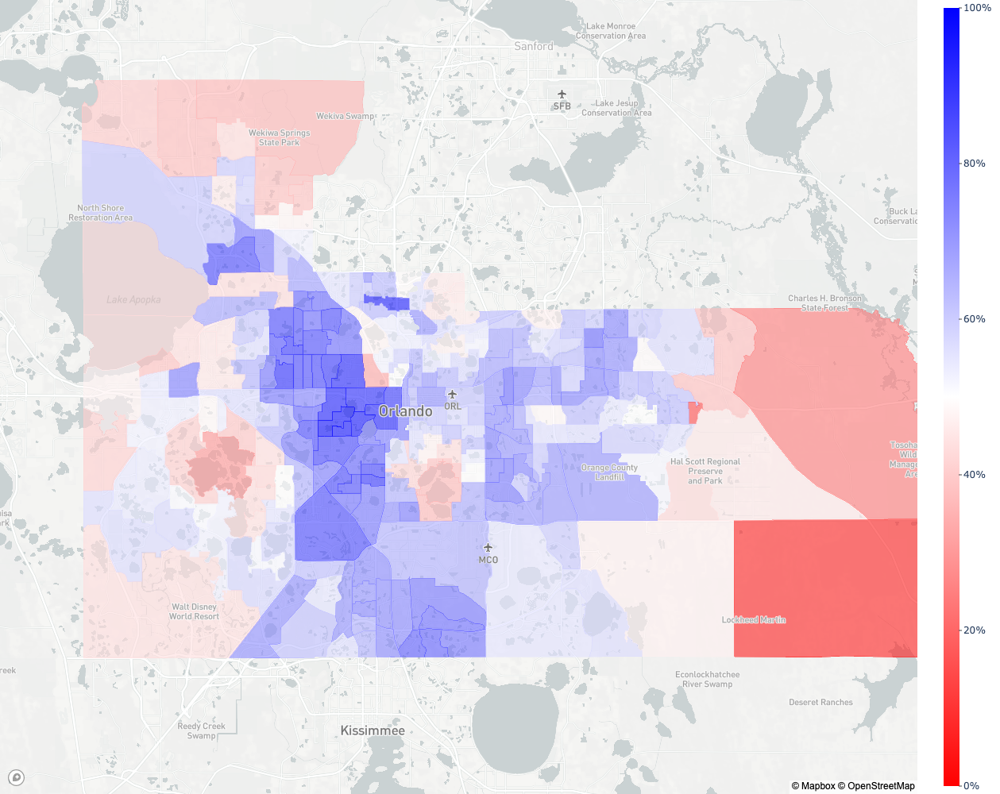

In [10]:
fig.update_layout(
    mapbox_style="light",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0}
)
fig.show()

# load 2020 data

In [11]:
import pandas as pd

In [12]:
precincts_2020 = pd.read_csv('./orange_2020_from_pdf.csv', index_col='countypct')

columns = precincts_2020.columns
print(columns)
candidates = [col for col in columns if not ' VOTES' in col]
print(candidates)
precincts_2020.loc[:, "votes_all"] = precincts_2020[candidates].sum(axis=1) 

precincts_2020.rename(columns={"Donald J. Trump": "votes_rep", "Joseph R. Biden": "votes_dem"}, inplace=True)

# pasted...
precincts_2020.loc[:, "votes_oth"] = precincts_2020["votes_all"] - precincts_2020["votes_dem"] - precincts_2020["votes_rep"]

cols_to_keep = ["votes_dem", "votes_rep", "votes_oth", "votes_all"]
precincts_2020 = precincts_2020[cols_to_keep]

precincts_2020 = precincts_2020.drop("ORA631")
precincts_2020 = precincts_2020[precincts_2020["votes_all"] > 0]

precincts_2020.loc[:, "frac_dem"] = precincts_2020["votes_dem"] / precincts_2020["votes_all"]
precincts_2020.loc[:, "frac_rep"] = precincts_2020["votes_rep"] / precincts_2020["votes_all"]
precincts_2020.loc[:, "frac_oth"] = precincts_2020["votes_oth"] / precincts_2020["votes_all"]
precincts_2020.loc[:, "frac_twoway_dem"] = precincts_2020["votes_dem"] / precincts_2020[["votes_dem", "votes_rep"]].sum(axis=1)
precincts_2020.loc[:, "frac_twoway_rep"] = precincts_2020["votes_rep"] / precincts_2020[["votes_dem", "votes_rep"]].sum(axis=1)
precincts_2020.loc[:, "margin_votes_dem"] = precincts_2020["votes_dem"] - precincts_2020["votes_rep"]
precincts_2020.loc[:, "margin_frac_dem"] = precincts_2020["frac_dem"] - precincts_2020["frac_rep"]
precincts_2020.loc[:, "margin_frac_twoway_dem"] = precincts_2020["frac_twoway_dem"] - precincts_2020["frac_twoway_rep"]

print("n rows:", len(precincts_2020))
precincts_2020.head()

Index(['Don Blankenship', 'Donald J. Trump', 'Gloria La Riva', 'Howie Hawkins',
       'Jo Jorgensen', 'Joseph R. Biden', 'OVER VOTES',
       'Roque "Rocky" De La Fuente', 'UNDER VOTES', 'WRITE-IN'],
      dtype='object')
['Don Blankenship', 'Donald J. Trump', 'Gloria La Riva', 'Howie Hawkins', 'Jo Jorgensen', 'Joseph R. Biden', 'Roque "Rocky" De La Fuente', 'WRITE-IN']
n rows: 246


,votes_dem,votes_rep,votes_oth,votes_all,frac_dem,frac_rep,frac_oth,frac_twoway_dem,frac_twoway_rep,margin_votes_dem,margin_frac_dem,margin_frac_twoway_dem
countypct,,,,,,,,,,,,
ORA101,2169,1244,40,3453,0.628149,0.360266,0.011584,0.635511,0.364489,925,0.267883,0.271023
ORA102,1382,887,30,2299,0.601131,0.385820,0.013049,0.609079,0.390921,495,0.215311,0.218158
ORA103,1203,1004,32,2239,0.537293,0.448414,0.014292,0.545084,0.454916,199,0.088879,0.090168
ORA104,1994,1332,46,3372,0.591340,0.395018,0.013642,0.599519,0.400481,662,0.196323,0.199038
ORA105,1328,555,25,1908,0.696017,0.290881,0.013103,0.705258,0.294742,773,0.405136,0.410515


In [13]:
precincts_2020.loc["ORA522"]

votes_dem                 1228.000000
votes_rep                 1220.000000
votes_oth                   33.000000
votes_all                 2481.000000
frac_dem                     0.494962
frac_rep                     0.491737
frac_oth                     0.013301
frac_twoway_dem              0.501634
frac_twoway_rep              0.498366
margin_votes_dem             8.000000
margin_frac_dem              0.003225
margin_frac_twoway_dem       0.003268
Name: ORA522, dtype: float64

# merge data

In [14]:
precincts_2016_2020 = precincts_2016.join(precincts_2020, rsuffix="_2020", lsuffix="_2016")

precincts_2016_2020.loc[:, "margin_frac_twoway_dem_change"] = precincts_2016_2020["margin_frac_twoway_dem_2020"] - precincts_2016_2020["margin_frac_twoway_dem_2016"]
precincts_2016_2020.loc[:, "margin_votes_dem_change"] = precincts_2016_2020["margin_votes_dem_2020"] - precincts_2016_2020["margin_votes_dem_2016"]
precincts_2016_2020.loc[:, "votes_all_change"] = precincts_2016_2020["votes_all_2020"] - precincts_2016_2020["votes_all_2016"]
precincts_2016_2020.loc[:, "votes_all_ratio"] = precincts_2016_2020["votes_all_2020"] / precincts_2016_2020["votes_all_2016"]
precincts_2016_2020.loc[:, "votes_all_change_percent"] = precincts_2016_2020["votes_all_ratio"] - 1

precincts_2016_2020.head()

,votes_dem_2016,votes_rep_2016,votes_oth_2016,votes_all_2016,geometry,frac_dem_2016,frac_rep_2016,frac_oth_2016,frac_twoway_dem_2016,frac_twoway_rep_2016,...,frac_twoway_dem_2020,frac_twoway_rep_2020,margin_votes_dem_2020,margin_frac_dem_2020,margin_frac_twoway_dem_2020,margin_frac_twoway_dem_change,margin_votes_dem_change,votes_all_change,votes_all_ratio,votes_all_change_percent
countypct,,,,,,,,,,,,,,,,,,,,,
ORA101,1995,1054,118,3167,"POLYGON Z ((504909.204 1523375.895 0.000, 5049...",0.629934,0.332807,0.037259,0.654313,0.345687,...,0.635511,0.364489,925,0.267883,0.271023,-0.037603,-16,286,1.090306,0.090306
ORA102,1174,794,97,2065,"POLYGON Z ((499427.900 1523225.458 0.000, 4994...",0.568523,0.384504,0.046973,0.596545,0.403455,...,0.609079,0.390921,495,0.215311,0.218158,0.025068,115,234,1.113317,0.113317
ORA103,978,850,89,1917,"POLYGON Z ((485063.981 1522998.231 0.000, 4849...",0.510172,0.443401,0.046427,0.535011,0.464989,...,0.545084,0.454916,199,0.088879,0.090168,0.020146,71,322,1.167971,0.167971
ORA104,1651,1234,126,3011,"POLYGON Z ((497127.251 1529739.702 0.000, 4971...",0.548323,0.409831,0.041847,0.572270,0.427730,...,0.599519,0.400481,662,0.196323,0.199038,0.054497,245,361,1.119894,0.119894
ORA105,1287,405,60,1752,"POLYGON Z ((477486.115 1540281.324 0.000, 4774...",0.734589,0.231164,0.034247,0.760638,0.239362,...,0.705258,0.294742,773,0.405136,0.410515,-0.110761,-109,156,1.089041,0.089041


In [15]:
precincts_2016_2020[
    ["centroid", "votes_all_2020", "margin_votes_dem_2020", "margin_votes_dem_change", "votes_all_change_percent", "margin_frac_twoway_dem_change"]
].sort_values("margin_votes_dem_change", ascending=True)

,centroid,votes_all_2020,margin_votes_dem_2020,margin_votes_dem_change,votes_all_change_percent,margin_frac_twoway_dem_change
countypct,,,,,,
ORA322,POINT (-81.30259 28.49042),3005,772,-748,-0.006612,-0.260420
ORA428,POINT (-81.37263 28.35616),2280,834,-525,0.057024,-0.282203
ORA318,POINT (-81.27783 28.49268),2336,552,-523,0.045658,-0.263760
ORA427,POINT (-81.34363 28.37416),4080,1496,-508,0.161731,-0.220523
ORA538,POINT (-81.19716 28.60144),807,400,-500,-0.590771,0.012170
...,...,...,...,...,...,...
ORA141,POINT (-81.57707 28.44758),5479,1107,540,0.400204,0.051034
ORA430,POINT (-81.25886 28.36770),7593,1078,647,0.884587,0.031128
ORA124,POINT (-81.49245 28.37525),4647,2057,779,0.549000,-0.003411


# simple scatter of Dem two-way performance by precinct for 2016 vs 2020

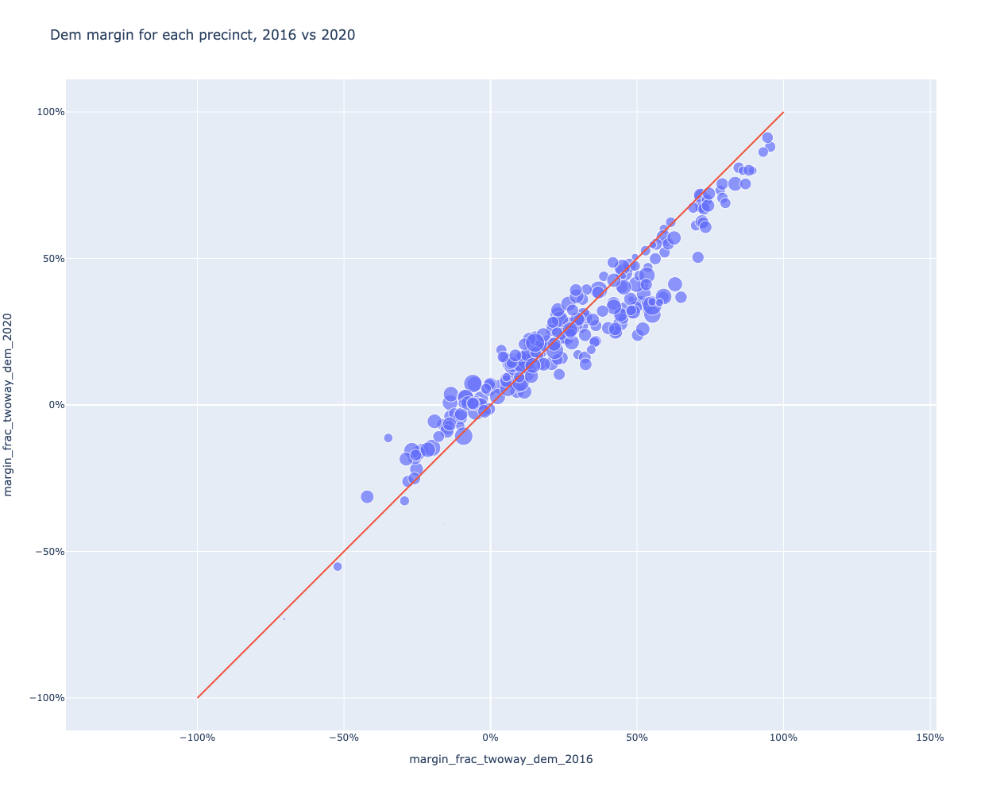

In [16]:
import plotly.express as px
fig = px.scatter(
    precincts_2016_2020.reset_index(),
    x="margin_frac_twoway_dem_2016",
    y="margin_frac_twoway_dem_2020",
    size="votes_all_2020",
    hover_data=['countypct'],
    title="Dem margin for each precinct, 2016 vs 2020",
)
fig.add_trace(
    go.Scatter(
        x=[-1, 1],
        y=[-1, 1],
        mode="lines",
        showlegend=False
    )
)
fig.update_layout(height=1000, xaxis=dict(tickformat = ',.0%'), yaxis=dict(scaleanchor="x", tickformat = ',.0%'))
fig.show()


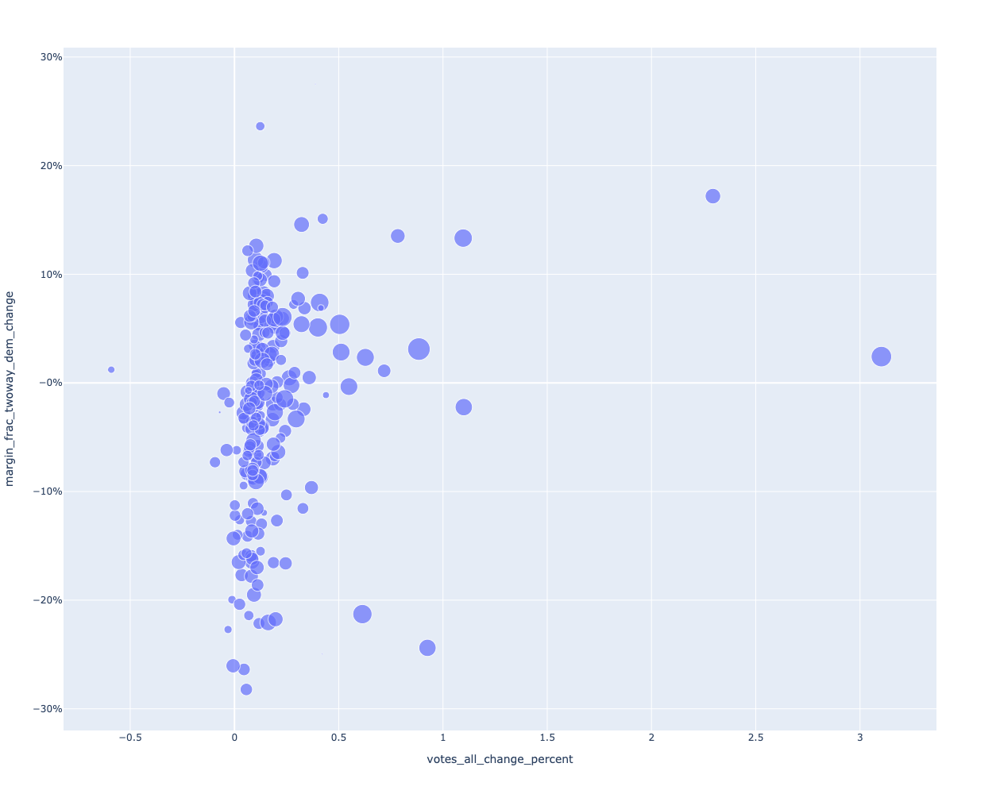

In [21]:
import plotly.express as px
fig = px.scatter(
    precincts_2016_2020.reset_index(),
    x="votes_all_change_percent",
    y="margin_frac_twoway_dem_change",
    size='votes_all_2020',
    hover_data=['countypct', 'votes_dem_2016', 'votes_rep_2016', 'votes_dem_2020', 'votes_rep_2020', 'margin_votes_dem_change']
)
fig.update_layout(height=1000, yaxis=dict(tickformat = ',.0%'))
fig.show()


In [22]:
precincts_2016_2020.loc["ORA140"]

votes_dem_2016                                                                 831
votes_rep_2016                                                                 619
votes_oth_2016                                                                  79
votes_all_2016                                                                1529
geometry                         POLYGON Z ((469976.8980714711 1490335.56434401...
frac_dem_2016                                                             0.543492
frac_rep_2016                                                              0.40484
frac_oth_2016                                                            0.0516678
frac_twoway_dem_2016                                                      0.573103
frac_twoway_rep_2016                                                      0.426897
margin_votes_dem_2016                                                          212
margin_frac_dem_2016                                                      0.138653
marg

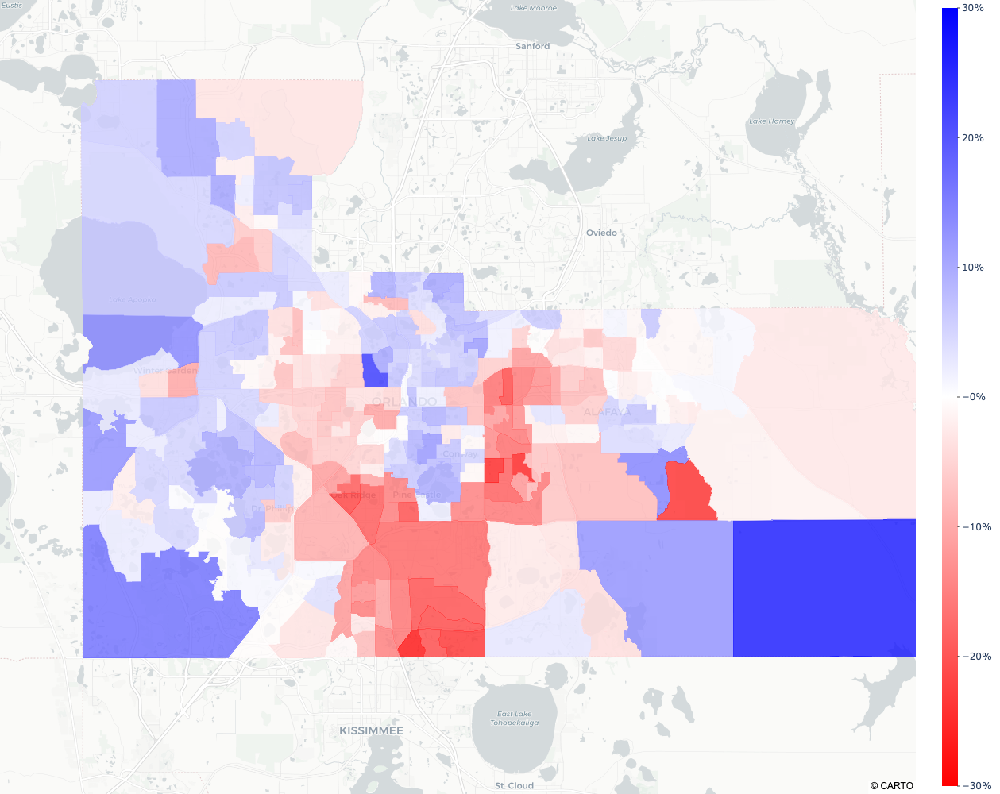

In [23]:
data = go.Choroplethmapbox(
    geojson=precincts_2016_2020["geometry"].to_crs(epsg=4326).__geo_interface__,
    locations=precincts_2016_2020.index,
    z=precincts_2016_2020["margin_frac_twoway_dem_change"],
    zmin=-0.30,
    zmax=0.30,
    marker_line_width=0,
    colorbar=dict(thickness=20, ticklen=3, tickformat='%',outlinewidth=0),
    colorscale=[
        (0, "red"),
#         (0.40, "rgb(255, 200, 200)"),
        (0.5, "white"),
#         (0.60, "rgb(200, 200, 255)"),
        (1, "blue")],
    marker_opacity=0.8,
    name="precincts",
)

fig = go.Figure(data)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},  # ORL airport
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0},
)

fig.show()

In [24]:
fig.write_image(file="./choropleth-margin_frac_twoway_dem_change.jpg", width=1920, height=1200)

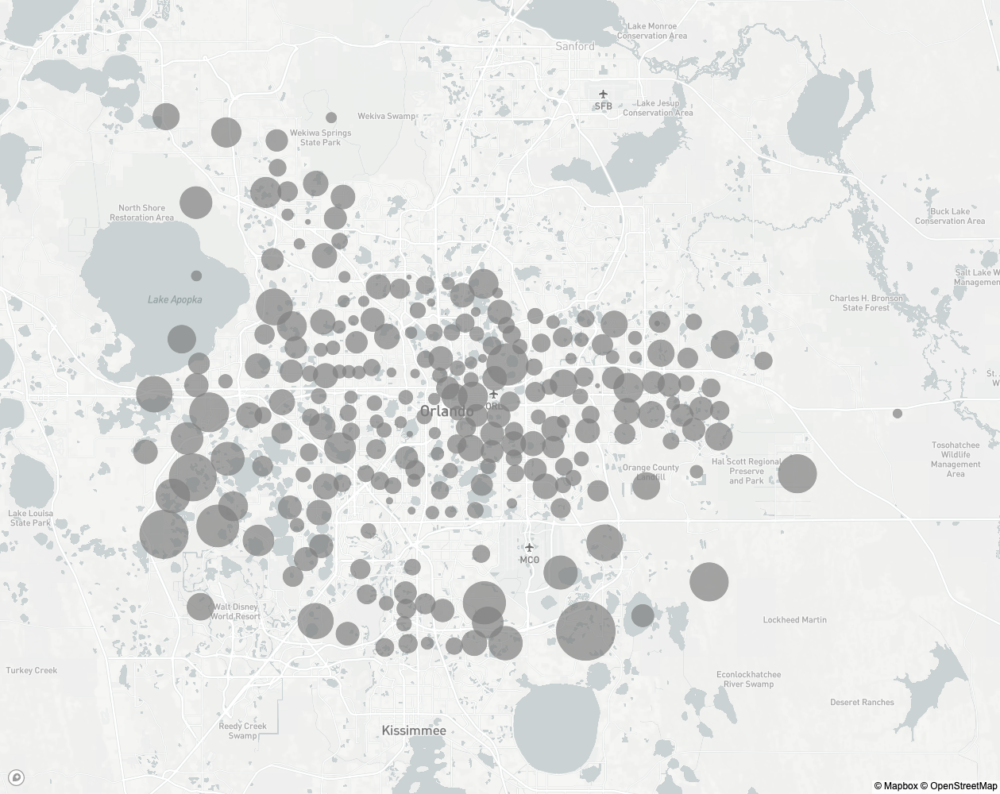

In [52]:
data = go.Scattermapbox(
    lat=precincts_2016_2020.set_geometry('centroid').geometry.y,
    lon=precincts_2016_2020.set_geometry('centroid').geometry.x,
    mode="markers",
    marker_size=precincts_2016_2020["votes_all_2020"] / 100,
    marker_color="gray",
    text=precincts_2016_2020.index
)

fig = go.Figure(data)

fig.update_layout(
    mapbox_style="light",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},  # ORL airport
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0},
)

fig.show()

In [50]:
fig.write_image("./out.jpg", width=1920, height=1200)

In [71]:
precincts_2016_2020.loc[:, "centroid_lat"] = precincts_2016_2020.set_geometry('centroid').geometry.y
precincts_2016_2020.loc[:, "centroid_lon"] = precincts_2016_2020.set_geometry('centroid').geometry.x

precincts_2016_2020.loc[:, "margin_votes_abs_change"] = precincts_2016_2020["margin_votes_dem_change"].abs()
precincts_2016_2020.loc[:, "margin_votes_dem_is_positive"] = precincts_2016_2020["margin_votes_dem_change"] > 0

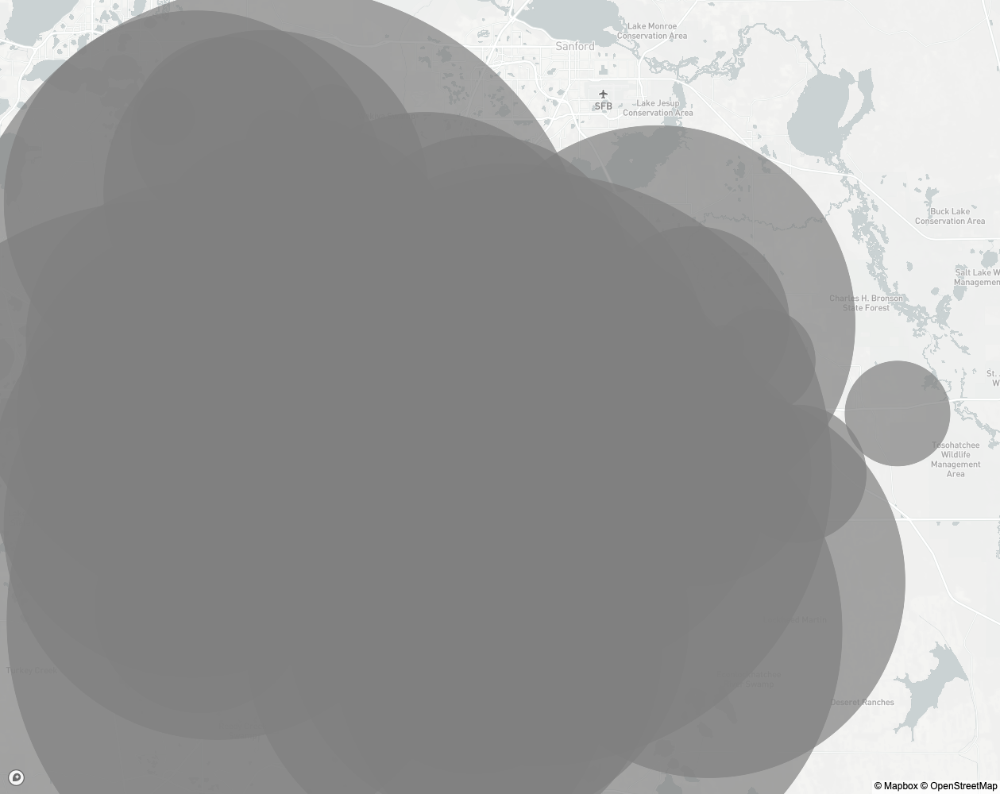

In [54]:

data = go.Scattermapbox(
    lat=precincts_2016_2020.set_geometry('centroid').geometry.y,
    lon=precincts_2016_2020.set_geometry('centroid').geometry.x,
    mode="markers",
    marker_size=precincts_2016_2020["margin_votes_abs_change"],
    marker_color="gray",
    text=precincts_2016_2020.index
)

fig = go.Figure(data)

fig.update_layout(
    mapbox_style="light",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},  # ORL airport
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0},
)

fig.show()

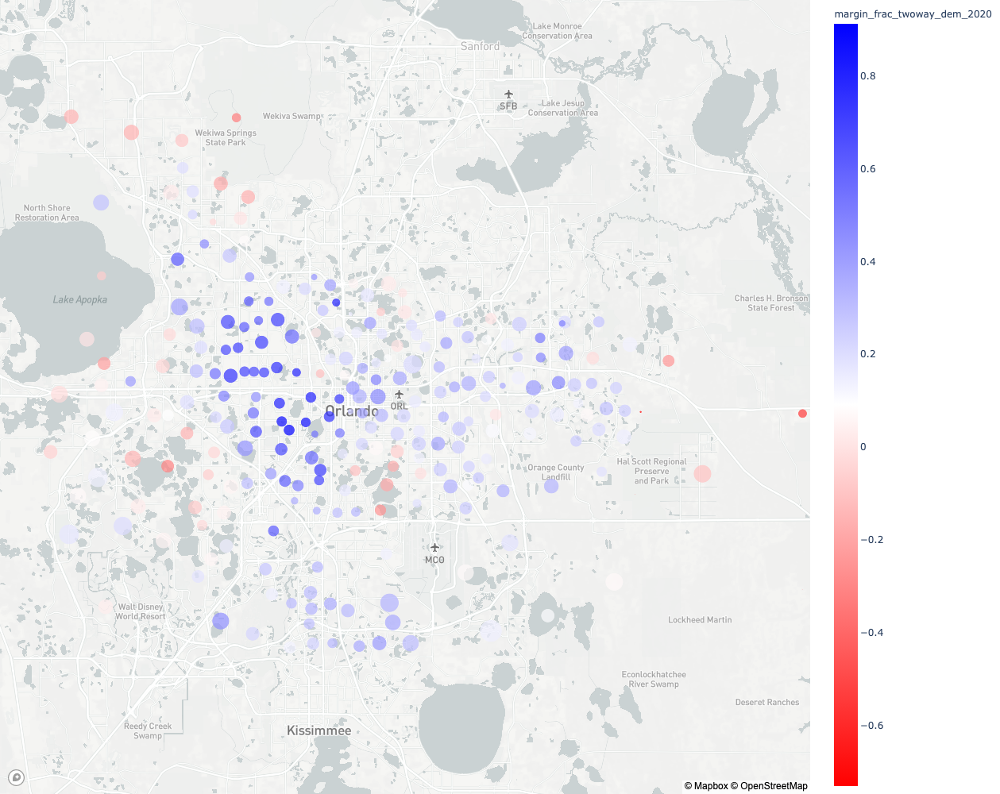

In [62]:
px.set_mapbox_access_token(MAPBOX_ACCESSTOKEN)

fig = px.scatter_mapbox(
    precincts_2016_2020,
    lat="centroid_lat",
    lon="centroid_lon",
    color="margin_frac_twoway_dem_2020",
    size="votes_all_2020",
    color_continuous_scale=[(0, "red"), (0.5, "white"), (1, "blue")],
    zoom=10)


fig.update_layout(
    mapbox_style="light",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},  # ORL airport
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0},
)

fig.show()


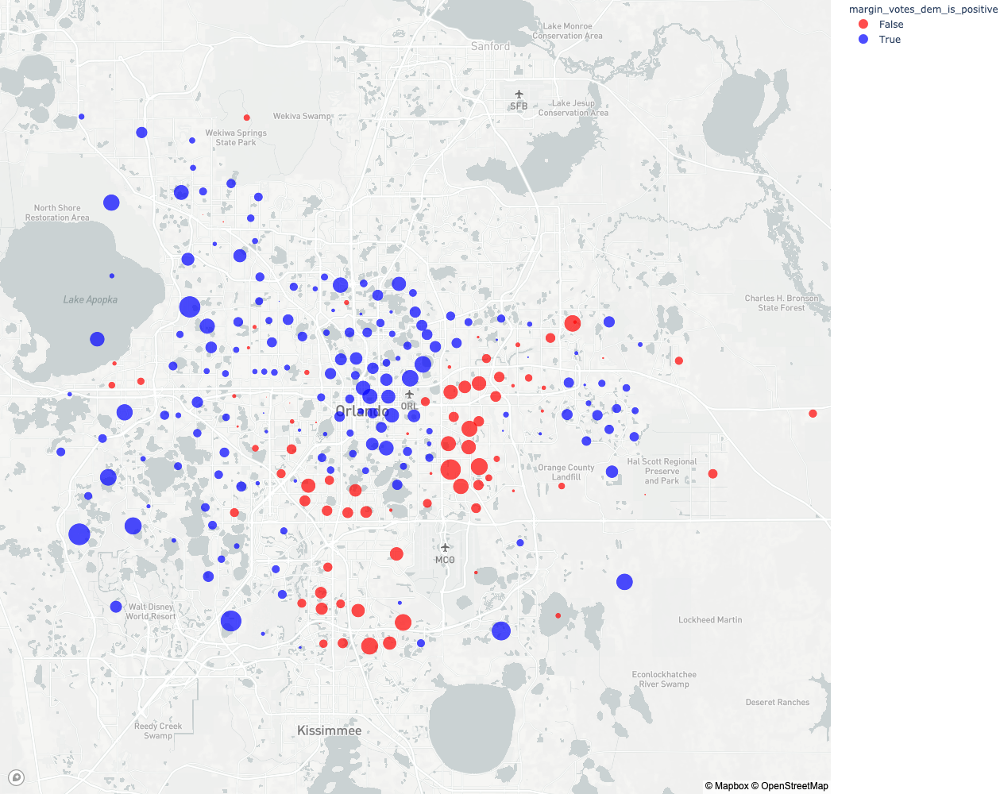

In [74]:
px.set_mapbox_access_token(MAPBOX_ACCESSTOKEN)

fig = px.scatter_mapbox(
    precincts_2016_2020,
    lat="centroid_lat",
    lon="centroid_lon",
    color="margin_votes_dem_is_positive",
    size="margin_votes_abs_change",
    color_discrete_sequence=["red", "blue"],
    zoom=10)

fig.update_layout(
    mapbox_style="light",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},  # ORL airport
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0},
)

fig.show()
